# Purpose: Old script for checking a previous version of my data generation code to ensure that the training samples are good

In [6]:
import tables
import numpy as np
import matplotlib.pyplot as plt
import glob
from astropy.io import fits
from astropy.visualization import LinearStretch, ZScaleInterval, ImageNormalize
import sep
import pickle as pkl

In [2]:
# fileh = tables.open_file('/media/rd1/ztf_neos/training_examples/batches/fixed_norm_no_cosmic_rays.h5', mode='r')
# fileh = tables.open_file('/media/rd1/ztf_neos/training_examples/batches/fixed_norm_no_cosmic_rays_size200.h5', mode='r')
# fileh = tables.open_file('/media/rd1/ztf_neos/training_examples/batches/fixed_norm_no_cosmic_rays_use_psf_size150_percentile68x3_minlen8.h5', mode='r')
# fileh = tables.open_file('/media/rd1/ztf_neos/training_examples/batches/fixed_norm_no_cosmic_rays_use_psf_size150_percentile68x3_minlen3.h5', mode='r')
fileh = tables.open_file('/mnt/etdisk9/ztf_neos/training_examples/batches/fixed_norm_no_cosmic_rays_use_psf_size150_stdx3_minlen4.h5', mode='r')

In [3]:
train_images = fileh.root.train_images
train_labels = fileh.root.train_labels

In [4]:
val_images = fileh.root.val_images
val_labels = fileh.root.val_labels[:]

In [7]:
with open("/mnt/etdisk9/ztf_neos/training_examples/batches/fixed_norm_no_cosmic_rays_use_psf_size150_stdx3_minlen4.train.metadata.pkl", "rb") as f:
    metadata_train = pkl.load(f)

In [17]:
print(metadata_train[237])

{'x': 110, 'y': 40, 'amp_min': 21.195133209228516, 'factor': 1.0847460760199732, 'length': 8.408770850645826, 'rotation': 4.265250722117479, 'width': 2.5186342843398752, 'hard_neg': True, 'sci_file': '/mnt/etdisk9/ztf_neos/training_examples/science/ztf_20180909499398_000453_zr_c13_o_q4_sciimg.fits', 'ref_file': '/mnt/etdisk9/ztf_neos/training_examples/reference/ztf_000453_zr_c13_q4_refimg.fits'}


/opt/anaconda/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


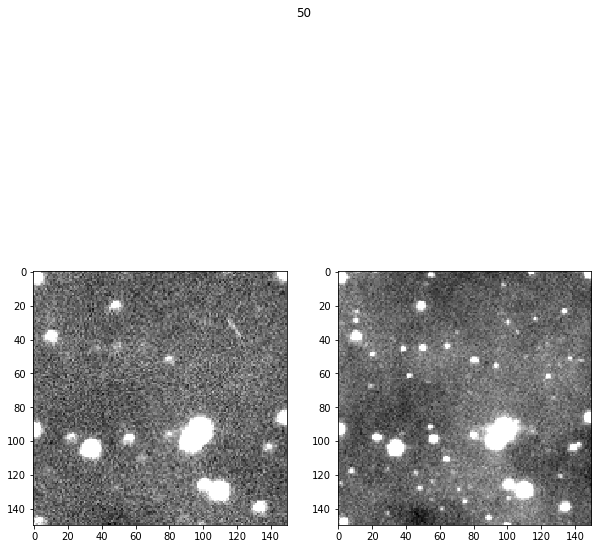

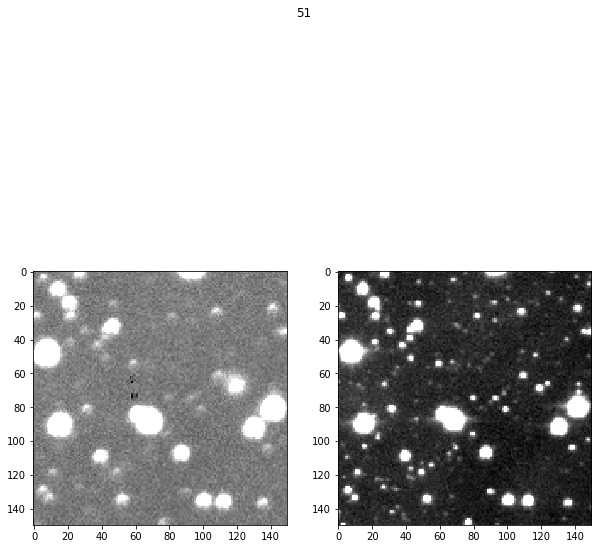

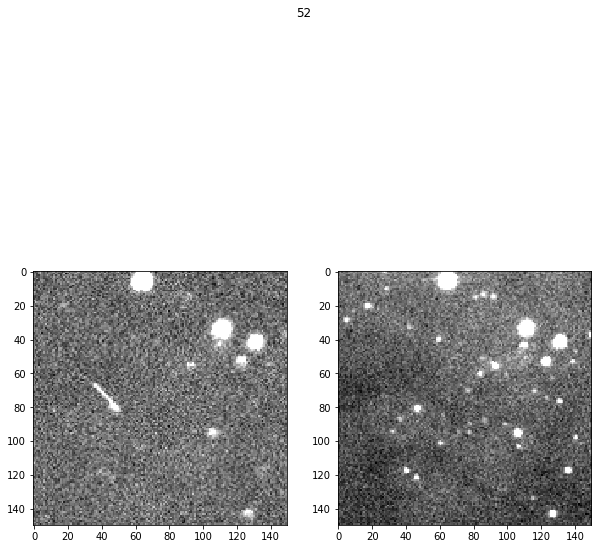

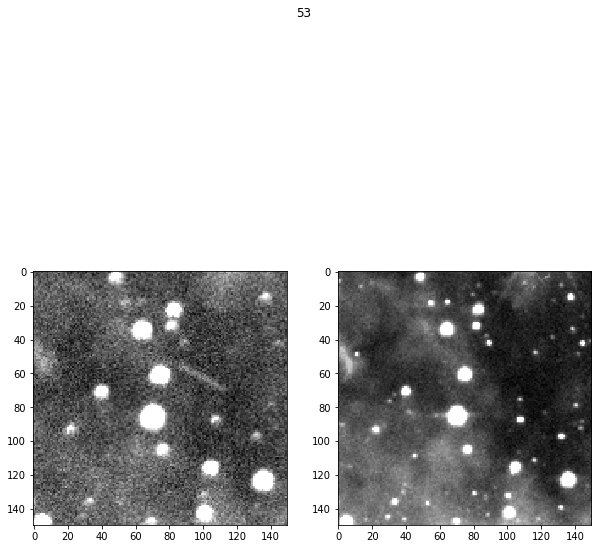

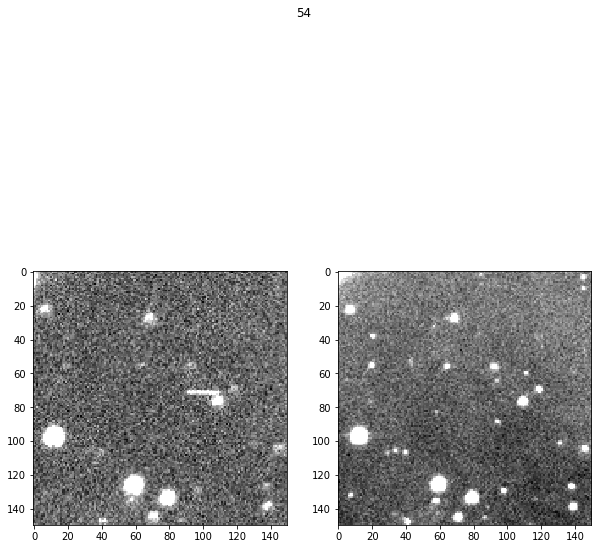

...

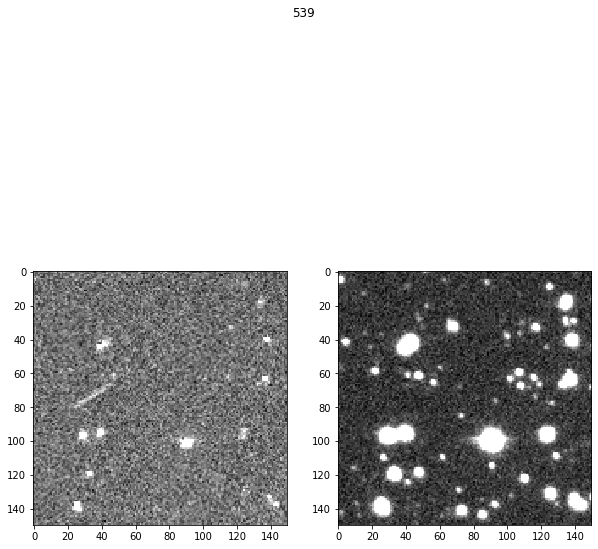

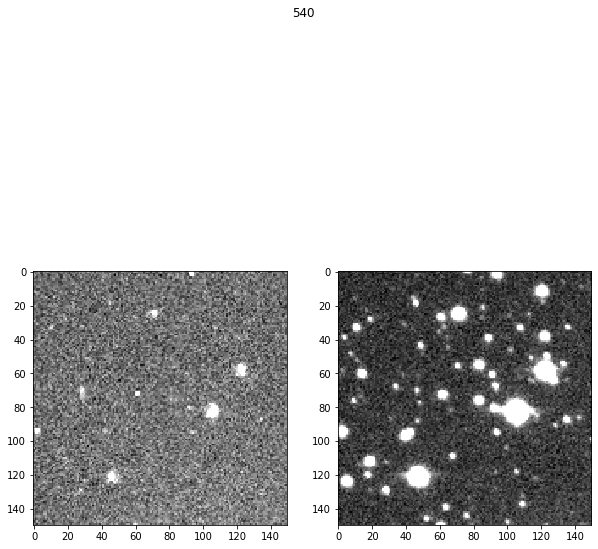

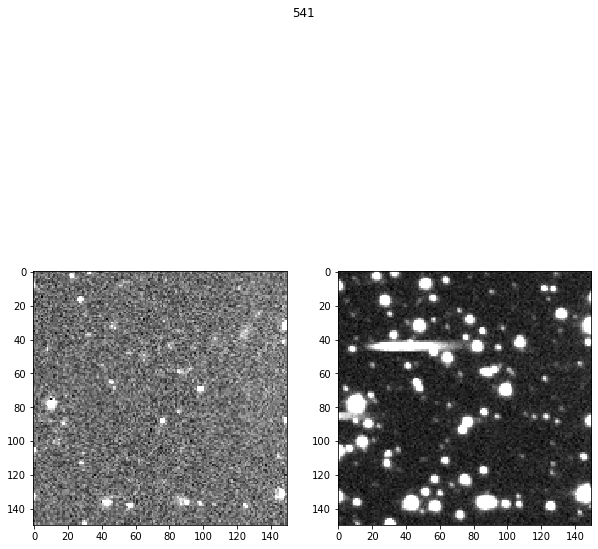

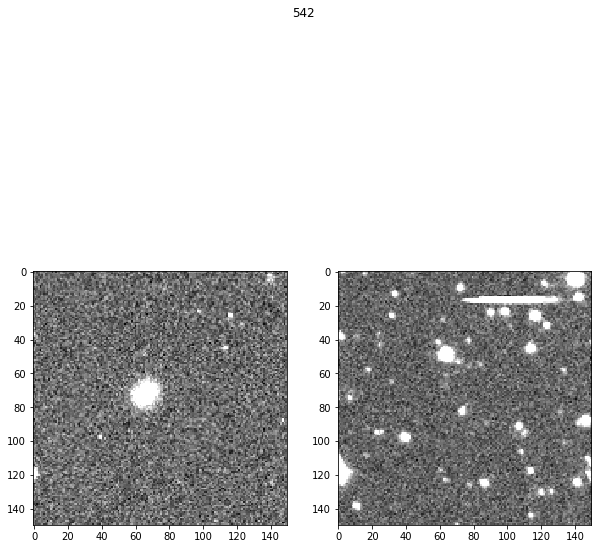

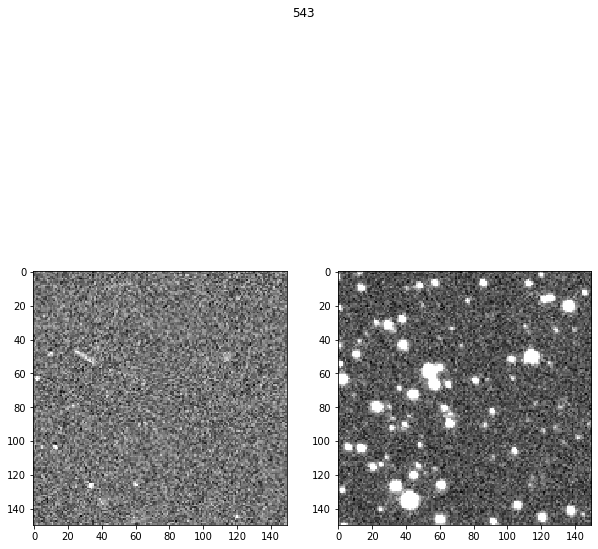

Error in callback <function flush_figures at 0x7f0423deca70> (for post_execute):


KeyboardInterrupt: 

In [8]:
for i in np.where(train_labels[:] == 1)[0]:
#     print(train_labels[i])
    plt.figure(figsize=(10, 20))
    plt.suptitle(i)
    plt.subplot(2, 2, 1)
    plt.imshow(train_images[i][..., 0], cmap="gray")
    plt.subplot(2, 2, 2)
    plt.imshow(train_images[i][..., 1], cmap="gray")

In [5]:
class PyTablesSequences():

    def __init__(self, x_arr, y_arr, batch_size, buffer_size=2048):
        self.x, self.y = x_arr, y_arr
        self.batch_size = batch_size
        self.buffer_size = buffer_size
        self.next_load = 0

    def __len__(self):
        return int(np.ceil(len(self.x) / float(self.batch_size)))

    def __getitem__(self, idx):
        # print(idx)
        if idx >= self.next_load or idx < self.next_load - self.buffer_size:
            self.x_block = self.x[idx:idx + self.buffer_size]
            self.y_block = self.y[idx:idx + self.buffer_size]
            indexes = np.random.permutation(self.buffer_size)
            self.x_block = self.x_block[indexes]
            self.y_block = self.y_block[indexes]
            self.next_load += self.buffer_size

        block_index = idx - (self.next_load - self.buffer_size)
        batch_x = self.x_block[block_index:block_index + self.batch_size]
        batch_y = self.y_block[block_index:block_index + self.batch_size]

        batch_x[~np.isfinite(batch_x)] = 0

        return batch_x, batch_y


In [6]:
train_data = PyTablesSequences(train_images, train_labels, 32, 9984)

In [7]:
val_data = PyTablesSequences(val_images, val_labels, 256, buffer_size=9984)

In [8]:
x, y = val_data[0]

IndexError: index 2298 is out of bounds for axis 0 with size 800

In [30]:
len(x)

256

In [9]:
plt.imshow(train_data[5][0][0][..., 0], cmap="gray")
plt.figure()
plt.imshow(train_data[5][0][0][..., 1], cmap="gray")

IndexError: index 2956 is out of bounds for axis 0 with size 795

In [62]:
%%time
train_images[:2048][np.random.choice(2048, 2048, replace=False)]

CPU times: user 311 ms, sys: 2.19 s, total: 2.5 s
Wall time: 4.44 s


array([[[[ 3.99035722e-01, -5.26578009e-01],
         [-2.20725998e-01, -7.55815804e-01],
         [-1.12605810e+00, -8.05154145e-01],
         ...,
         [-1.12975883e+00, -1.51515618e-01],
         [ 1.52702555e-01,  6.44683372e-03],
         [ 2.90098071e-01, -6.70978367e-01]],

        [[ 2.29109004e-01, -2.20896780e-01],
         [ 5.28862655e-01, -2.43604779e-01],
         [-3.97478282e-01, -9.25098896e-01],
         ...,
         [-4.42041084e-03,  1.36193857e-01],
         [ 3.85915399e-01, -4.47924912e-01],
         [-2.69548893e-01, -4.87725377e-01]],

        [[-2.45800093e-01, -1.51743367e-01],
         [-3.06443185e-01, -3.63506436e-01],
         [-5.04070818e-01, -3.89967859e-01],
         ...,
         [ 4.25497442e-01, -2.56700329e-02],
         [-9.12226260e-01, -2.23671898e-01],
         [-1.56813025e+00,  7.05100238e-01]],

        ...,

        [[-1.18651636e-01, -2.99740911e-01],
         [-1.28868505e-01, -6.07836135e-02],
         [-9.41493869e-01, -7.62000307

In [ ]:
val_images = fileh.root.val_images[:10000]
val_labels = fileh.root.val_labels[:]

In [14]:
%%time
images = []
for i in range(0, 100):
    images.append(train_images[i])
images = np.array(images)

CPU times: user 0 ns, sys: 105 ms, total: 105 ms
Wall time: 247 ms


In [15]:
for i in range(10000):
    if np.sum(~np.isfinite(train_images[i])) > 0:
        print(i)

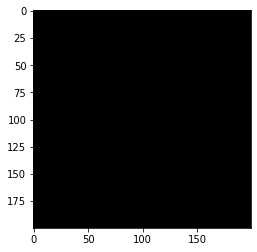

In [16]:
plt.imshow(np.isfinite(train_images[747][..., 0]), cmap="gray")

In [31]:
~np.isfinite(train_images[747][..., 0])

array([[False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       ...,
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False]])

In [30]:
print(train_images[747][..., 0][:, 10])

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan]


In [34]:
len(val_images)

56000

In [35]:
print(val_images[train_labels==1].shape)

(200, 200, 2)


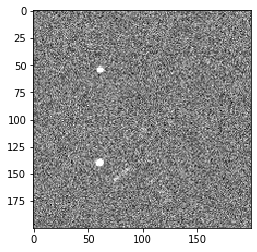

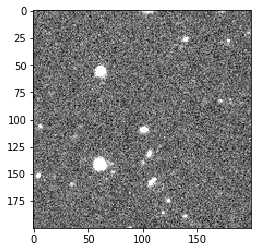

In [127]:
i = np.random.randint(21000)
indices = np.where(val_labels==1)[0]
plt.imshow(val_images[indices[i], ..., 0], cmap="gray")
plt.figure()
plt.imshow(val_images[indices[i], ..., 1], cmap="gray")
# print(indices[i])

In [80]:
filenames = glob.glob("/media/rd1/ztf_neos/training_examples/reference/*.fits")

In [139]:
size = 80
def normalize(arr, samples=size * size // 8):
    arr = np.copy(arr)
    vmin, vmax = ZScaleInterval(samples, contrast=0.3, max_iterations=3).get_limits(arr)
    arr -= vmin
    arr /= vmax - vmin
    arr = np.clip(arr, 0, 1)
    return (arr - 0.5) * 2

In [17]:
from photutils.background import *

In [52]:
image = np.array(fits.getdata(filenames[0]), dtype=np.float32)

# bkg_estimator = SExtractorBackground()
bkg = Background2D(image, (128, 128), mask=~np.isfinite(image), filter_size=(3, 3), exclude_percentile=20, edge_method="crop")

plt.figure(figsize=(10,10))
plt.imshow(normalize(image[1000:1080, 1000:1080], size*size//8), cmap="gray")

image -= bkg.background

plt.figure(figsize=(10,10))
plt.imshow(normalize(image[1000:1080, 1000:1080], size*size//8), cmap="gray")

KeyboardInterrupt: 

In [30]:
filenames = glob.glob("/media/rd1/ztf_neos/training_examples/resampled/resamp.fits")

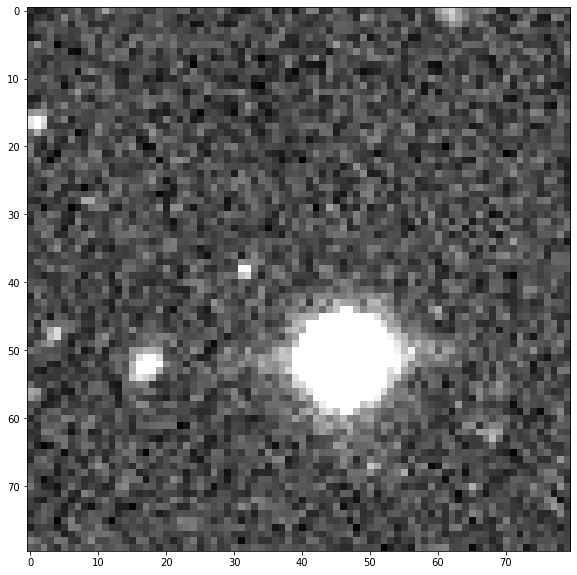

In [10]:
image = np.array(fits.getdata("/media/rd1/ztf_neos/training_examples/resampled/ztf_000761_zr_c12_q1_refimg.resamp.fits"), dtype=np.float32)
image -= sep.Background(image)
plt.figure(figsize=(10,10))
plt.imshow(normalize(image[1000:1080, 1000:1080], size*size//8), cmap="gray")

In [32]:
image = fits.getdata("/home/fwang/Pipeline/coadd.fits")

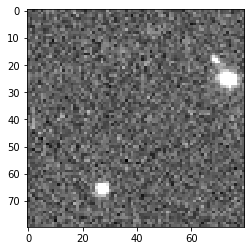

In [36]:
plt.imshow(normalize(image[100:180, 100:180]), cmap="gray")

In [142]:
import random
filenames = glob.glob("/media/rd1/ztf_neos/training_examples/reference/*.fits")
random.shuffle(filenames)

In [127]:
print(filenames[:10])

['/media/rd1/ztf_neos/training_examples/reference/ztf_000641_zr_c11_q2_refimg.fits', '/media/rd1/ztf_neos/training_examples/reference/ztf_000633_zr_c16_q1_refimg.fits', '/media/rd1/ztf_neos/training_examples/reference/ztf_000410_zr_c16_q1_refimg.fits', '/media/rd1/ztf_neos/training_examples/reference/ztf_000688_zg_c07_q3_refimg.fits', '/media/rd1/ztf_neos/training_examples/reference/ztf_000758_zg_c05_q4_refimg.fits', '/media/rd1/ztf_neos/training_examples/reference/ztf_000302_zr_c15_q4_refimg.fits', '/media/rd1/ztf_neos/training_examples/reference/ztf_000392_zg_c16_q4_refimg.fits', '/media/rd1/ztf_neos/training_examples/reference/ztf_000770_zr_c06_q3_refimg.fits', '/media/rd1/ztf_neos/training_examples/reference/ztf_000485_zr_c08_q1_refimg.fits', '/media/rd1/ztf_neos/training_examples/reference/ztf_000558_zg_c14_q4_refimg.fits']


In [147]:
image = fits.getdata(filenames[1])
# image = fits.getdata("/media/rd1/ztf_neos/training_examples/reference/ztf_000641_zr_c11_q2_refimg.fits")

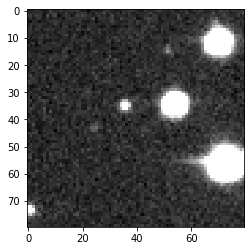

In [148]:
plt.imshow(normalize(image[1000:1080, 1000:1080]), cmap="gray")

In [2]:
filenames = [('/media/rd1/ztf_neos/training_examples/science/ztf_20180511473218_000591_zr_c12_o_q2_sciimg.fits', '/media/rd1/ztf_neos/training_examples/reference/ztf_000591_zr_c12_q2_refimg.fits'), ('/media/rd1/ztf_neos/training_examples/science/ztf_20180807334120_000342_zr_c09_o_q4_sciimg.fits', '/media/rd1/ztf_neos/training_examples/reference/ztf_000342_zr_c09_q4_refimg.fits'), ('/media/rd1/ztf_neos/training_examples/science/ztf_20180729487350_000736_zg_c06_o_q3_sciimg.fits', '/media/rd1/ztf_neos/training_examples/reference/ztf_000736_zg_c06_q3_refimg.fits'), ('/media/rd1/ztf_neos/training_examples/science/ztf_20180902275625_000549_zr_c14_o_q1_sciimg.fits', '/media/rd1/ztf_neos/training_examples/reference/ztf_000549_zr_c14_q1_refimg.fits'), ('/media/rd1/ztf_neos/training_examples/science/ztf_20180716397639_000440_zg_c10_o_q3_sciimg.fits', '/media/rd1/ztf_neos/training_examples/reference/ztf_000440_zg_c10_q3_refimg.fits'), ('/media/rd1/ztf_neos/training_examples/science/ztf_20181109225775_000805_zg_c02_o_q4_sciimg.fits', '/media/rd1/ztf_neos/training_examples/reference/ztf_000805_zg_c02_q4_refimg.fits'), ('/media/rd1/ztf_neos/training_examples/science/ztf_20180428174074_000672_zg_c04_o_q2_sciimg.fits', '/media/rd1/ztf_neos/training_examples/reference/ztf_000672_zg_c04_q2_refimg.fits'), ('/media/rd1/ztf_neos/training_examples/science/ztf_20180906271308_000290_zg_c13_o_q2_sciimg.fits', '/media/rd1/ztf_neos/training_examples/reference/ztf_000290_zg_c13_q2_refimg.fits'), ('/media/rd1/ztf_neos/training_examples/science/ztf_20180604467951_000832_zg_c03_o_q2_sciimg.fits', '/media/rd1/ztf_neos/training_examples/reference/ztf_000832_zg_c03_q2_refimg.fits'), ('/media/rd1/ztf_neos/training_examples/science/ztf_20181110106586_000442_zr_c07_o_q1_sciimg.fits', '/media/rd1/ztf_neos/training_examples/reference/ztf_000442_zr_c07_q1_refimg.fits')]